In [1]:
import os
import sys
sys.path.append('/mnt/mnt/5TB_slot2/Tobias')
sys.path.append('/mnt/mnt/5TB_slot2/Tobias/TobiasPy/fastMRI')
sys.path.append('/mnt/mnt/4TB_pcie/fastBrain/')
import h5py
import numpy as np
import numpy.fft as nf
import matplotlib.pyplot as plt
import torch
from torch.utils.data import DataLoader
from models.unet.unet_model import UnetModel as UnetModel
from FF_net import FF_net
from FF_net import FF_simple_net
from FF_net import FF_net_tanh
from FF_net import Complex_net
import argparse
from common.args import Args
import models.unet.run_unet  as Run
import torch.nn as nn
import logging
import pathlib
import random
from torch.utils.data import Dataset
import time
from torch.nn import functional as F
import shutil
from tensorboardX import SummaryWriter
import torchvision
from torchvision import transforms, utils
import net_utils as nu
import calendar
import datetime
from longOne import ComplexFourier,ComplexEndToEnd

import sigpy as sp
import sigpy.plot as pl
import vd_spiral

from FF_net import Complex_net_ext

%load_ext autoreload
%autoreload 2

In [2]:
sys.argv=['']
def create_arg_parser():
    timestamp = calendar.timegm(time.gmtime())
    human_readable = datetime.datetime.fromtimestamp(timestamp).isoformat()
    #human_readable="pure_inverse_fourier"
    human_readable="ComplexEndToEnd_onlyU"
    parser = argparse.ArgumentParser(description="ML parameters")
    parser.add_argument('--num-pools', type=int, default=4, help='Number of U-Net pooling layers')
    parser.add_argument('--drop-prob', type=float, default=0.0, help='Dropout probability')
    parser.add_argument('--num-chans', type=int, default=32, help='Number of U-Net channels')

    parser.add_argument('--batch-size', default=16, type=int, help='Mini batch size')
    parser.add_argument('--num-epochs', type=int, default=250, help='Number of training epochs')
    parser.add_argument('--lr', type=float, default=0.0001, help='Learning rate')
    parser.add_argument('--lr-step-size', type=int, default=100,
                        help='Period of learning rate decay')
    parser.add_argument('--lr-gamma', type=float, default=0.1,
                        help='Multiplicative factor of learning rate decay')
    parser.add_argument('--weight-decay', type=float, default=0.01,
                        help='Strength of weight decay regularization')
    parser.add_argument('--momentum', type=float, default=0.1,
                        help='Strength of optimizer momentum')

    parser.add_argument('--report-interval', type=int, default=10000, help='Period of loss reporting')
    parser.add_argument('--data-parallel', default=True,
                        help='If set, use multiple GPUs using data parallelism')
    parser.add_argument('--device', type=str, default='cuda',
                        help='Which device to train on. Set to "cuda" to use the GPU')
    parser.add_argument('--exp-dir', type=pathlib.Path, default='/mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelu_'+str(human_readable),
                        help='Path where model and results should be saved')
    parser.add_argument('--resume', action='store_true', default=False,
                        help='If set, resume the training from a previous model checkpoint. '
                             '"--checkpoint" should be set with this')
    parser.add_argument('--checkpoint', type=str, default='/mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelu_'+str(human_readable)+'/best_model.pt',
                        help='Path to an existing checkpoint. Used along with "--resume"')
    parser.add_argument('--logdir', type=str, default='/mnt/mnt/5TB_slot2/Tobias/Thesis/log/ff_lrelu_'+str(human_readable),
                        help='Path to an existing checkpoint. Used along with "--resume"')
    parser.add_argument('--seed', default=42, type=int, help='Seed for random number generators')
    parser.add_argument('--resolution', default=256, type=int, help='Resolution of images')
    parser.add_argument('--device_ids', default=[0,1] , help='GPUS used')
    return parser
args=create_arg_parser().parse_args()
print("save to",args.checkpoint)

save to /mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelu_ComplexEndToEnd_onlyU/best_model.pt


In [3]:
def test_fourier():
    sig = np.random.randn(args.resolution) + 1j*np.random.randn(320)
    F = np.fft.ifft(sig, axis=-1)
    # First half of inputs/outputs is real part, second half is imaginary part
    X = torch.from_numpy(np.hstack([sig.real, sig.imag])).double()
    Y = torch.from_numpy((F.real**2+F.imag**2)**(1/2)).double()
    return X,Y

class SliceData(Dataset):
    """
    A PyTorch Dataset that provides access to MR image slices.
    """
    
    def __init__(self, root="/mnt/mnt/5TB_slot2/fastMRI/multicoil_train", sample_rate=1.):
        self.examples = []
        #potential to apply pre-process transform
        files = list(pathlib.Path(root).iterdir())
        if sample_rate < 1:
            #random.shuffle(files)
            num_files = round(len(files) * sample_rate)
            files = files[:num_files]
        for fname in sorted(files):
            print(fname)
            try:
                #print(h5py.File(fname, 'r').keys())
                #maybe also only randomly select parts of slices. Otherwise lot of outer noise-like structures.
                xml = h5py.File(fname, 'r')['ismrmrd_header']
                kspace = h5py.File(fname, 'r')['kspace']
                num_slices = kspace.shape[0]
                num_channels=kspace.shape[1]
                if (kspace.shape[-2]<args.resolution) or (kspace.shape[-1]<args.resolution):# or num_channels!=16:
                    continue
                print(len(self.examples))
                for slice in range(num_slices):
                    crop_size = (min(args.resolution, kspace.shape[-2]),min(args.resolution, kspace.shape[-1]))
                    k=nu.center_crop(kspace[slice], crop_size)[0]
                    target=abs(nu.make_ift(k))
                    m=np.max(target)
                    if m>0:
                        target/=m
                    else:
                        continue
                    k=nu.to_tensor(k).unsqueeze(0)
                    us=nu.apply_mask(k)[0]#*args.resolution
                    us/=m
                    if np.isnan(np.sum(target)):
                        continue
                    X=us#.flatten()
                    print(X.shape)
                    #print(X.shape)
                    Y=nu.to_tensor(target)
                    #print(Y.shape)
                    #X,Y=test_fourier()
                    self.examples += [(fname, slice, X, Y)]
            except:
                print("Couldn't open file")
    
    def __len__(self):
        return len(self.examples)
    
    def __getitem__(self, i):
        fname, slice, f, t = self.examples[i]
#         with h5py.File(fname, 'r') as data:
#             full=to_tensor(data['kspace'][slice])
#             crop_size = (min(args.resolution, full.shape[-3]),min(args.resolution, full.shape[-2]))          
#             full=complex_center_crop(full,crop_size)
            
#             kspace = to_tensor(data['kspace'][slice])
#             crop_size = (min(args.resolution, kspace.shape[-3]), min(args.resolution, kspace.shape[-2]))
#             kspace=apply_mask(kspace)[0]
#             kspace = complex_center_crop(kspace, crop_size)
            
        return (f, t)

In [4]:
def create_data_loaders():
    #batch_size=32
    #mask_func = None
    #if args.mask_kspace:
    #    mask_func = MaskFunc(args.center_fractions, args.accelerations)
    train_data = SliceData(root="/mnt/mnt/4TB_pcie/fastBrain/multicoil_train",sample_rate=0.25)
    dev_data = SliceData(root="/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain",sample_rate=0.25)
    test_data = SliceData(root="/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain",sample_rate=0.05)
    train_loader = DataLoader(
        dataset=train_data,
        batch_size=args.batch_size,
        shuffle=True,
        num_workers=0,
        pin_memory=True,
    )
    dev_loader = DataLoader(
        dataset=dev_data,
        batch_size=args.batch_size,
        shuffle=True,
        num_workers=0,
        pin_memory=True,
    )
    test_loader=None
#     test_loader = DataLoader(
#         dataset=test_data,
#         num_workers=0,
#         pin_memory=True,
#     )
    return train_loader, dev_loader, test_loader

In [5]:
t=time.time()
train_loader, dev_loader, test_loader= create_data_loaders()
print("Time taken to load data: ",time.time()-t)

/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_200_6002442.h5
0
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_200_6002466.h5
16
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2]

torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_201_6002917.h5
256
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file

torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_201_6003008.h5
494
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_201_6003009.h5
510
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256,

torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_202_6000563.h5
730
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_202_6000576.h5
746
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256,

torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_200_2000333.h5
970
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fast

torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_200_2000466.h5
1210
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_200_2000467.h5
1226
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])

torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_200_6002010.h5
1450
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_200_6002111.h5
1466
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])

torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_209_2090185.h5
1690
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_209_2090189.h5
1706
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])

torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_209_2090254.h5
1944
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 2

torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_209_2090395.h5
2180
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_209_2090400.h5
2196
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])

torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXFLAIR_200_6002564.h5
14
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXFLAIR_200_6002625.h5
30
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 2

torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT1POST_202_6000378.h5
264
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test

torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT1POST_208_2080095.h5
504
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_

torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT1PRE_210_6001791.h5
744
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT1_202_202

torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_200_6002174.h5
980
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_200_6002250.h5
996
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 

torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_202_2020271.h5
1218
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_202_2020339.h5
1234
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256

torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_203_2030159.h5
1456
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_204_2040037.h5
1472
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256

torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_207_2070541.h5
1696
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_207_2070567.h5
1712
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256

torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_209_2090309.h5
1936
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_209_2090345.h5
1952
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256

torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_210_6001525.h5
2172
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_210_6001590.h5
2188
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256

torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_200_6002009.h5
222
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 256, 256, 2])
torch.Size([1, 25

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


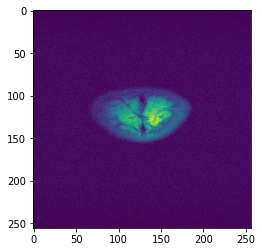

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


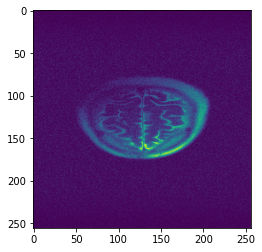

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


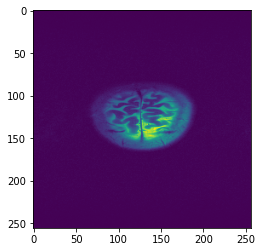

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


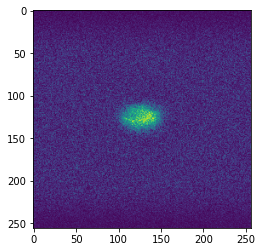

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


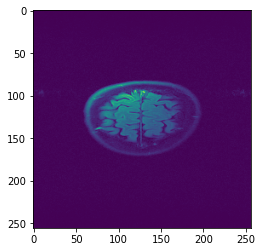

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


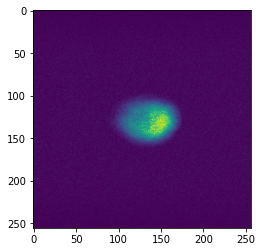

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


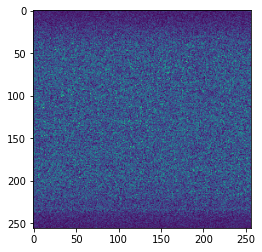

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


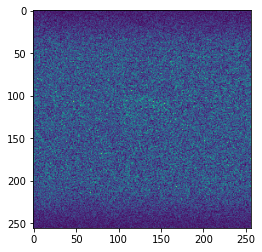

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


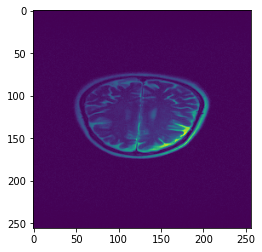

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


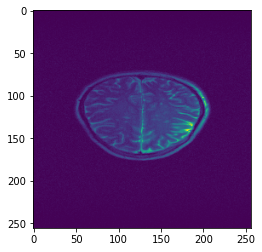

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


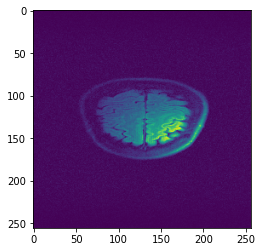

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


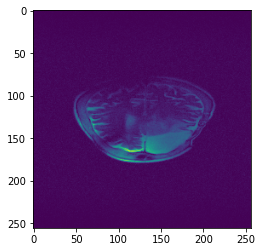

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


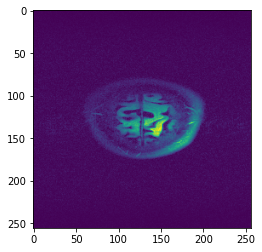

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


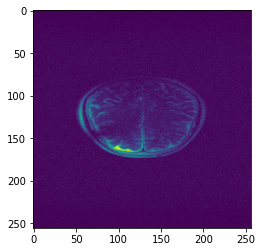

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


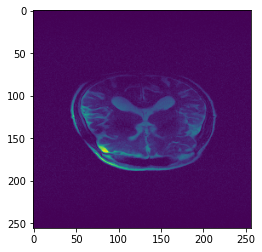

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


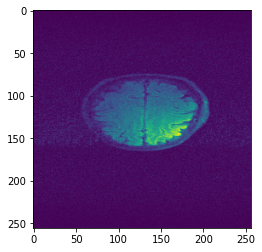

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


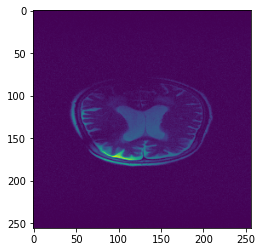

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


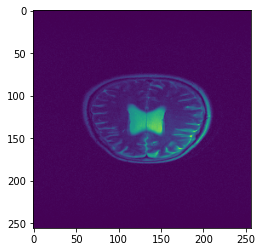

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


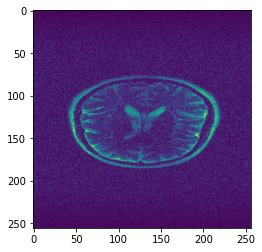

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


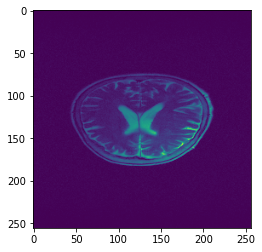

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


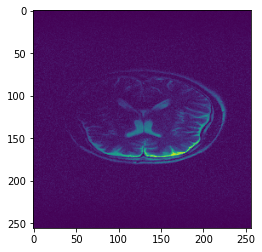

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


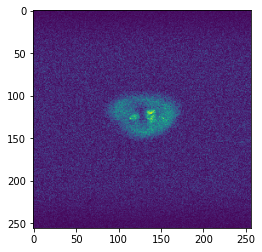

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


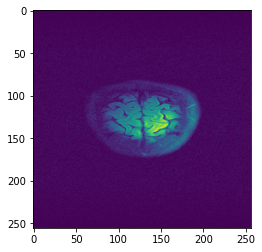

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


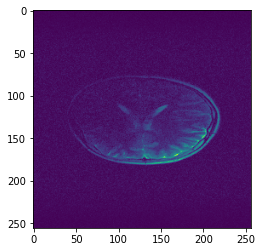

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


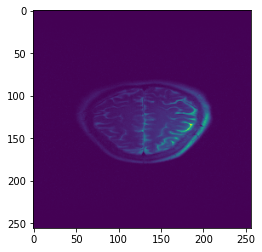

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


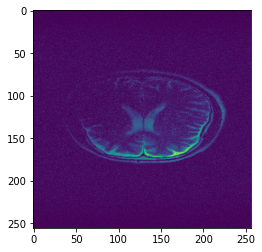

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


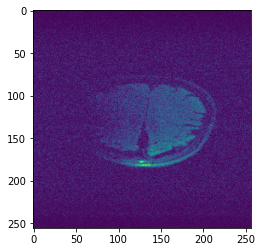

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


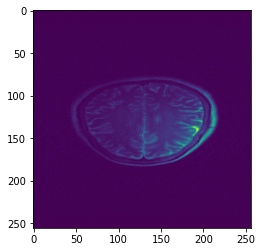

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


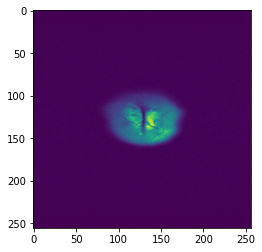

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


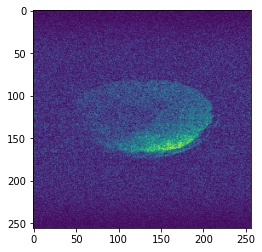

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


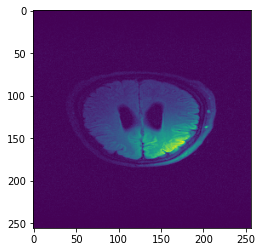

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


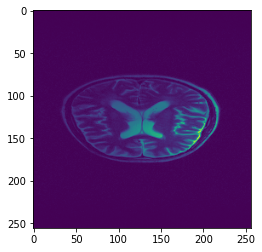

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


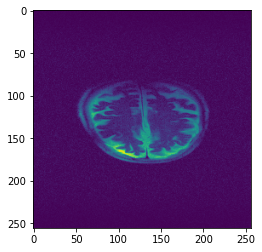

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


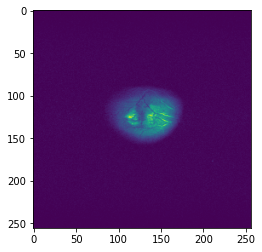

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


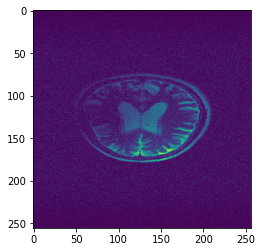

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


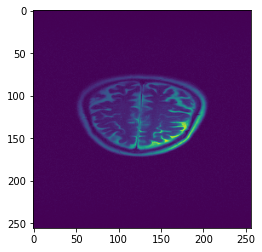

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


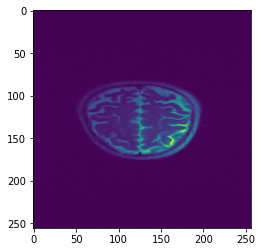

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


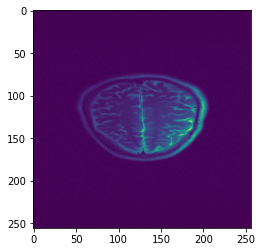

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


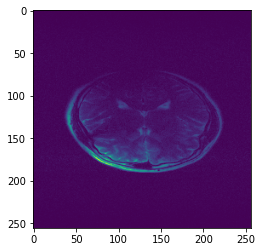

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


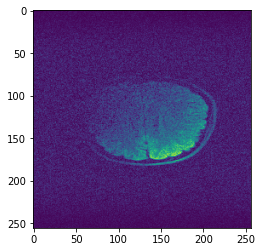

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


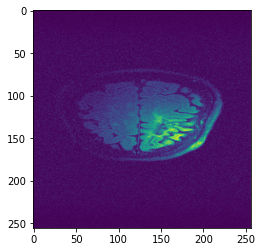

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


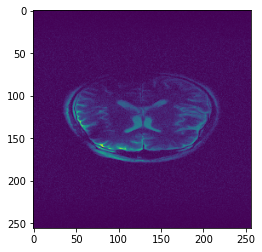

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


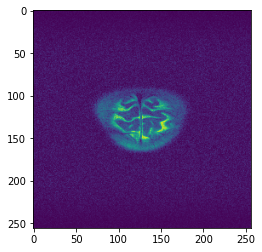

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


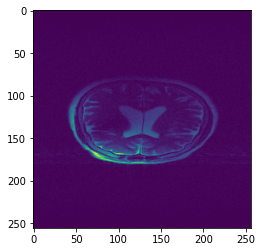

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


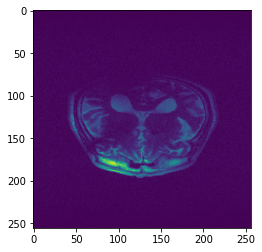

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


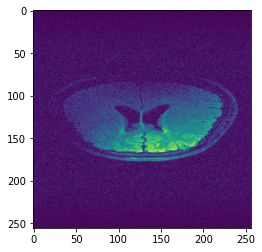

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


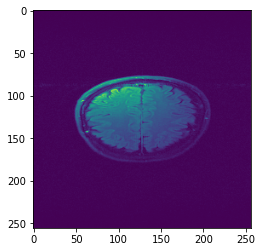

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


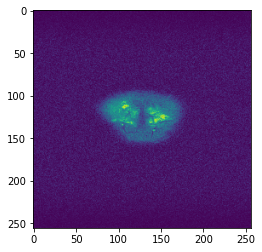

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


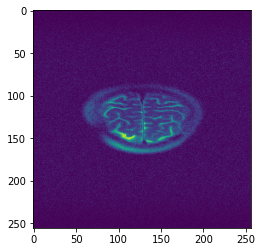

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


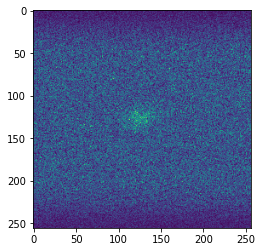

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


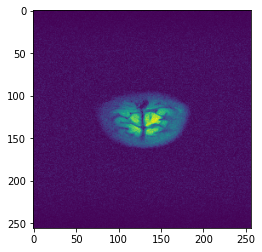

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


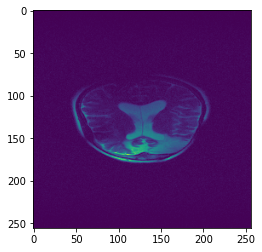

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


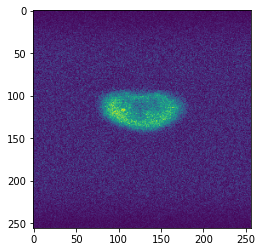

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


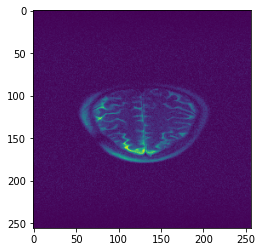

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


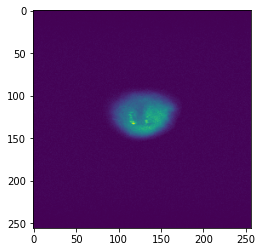

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


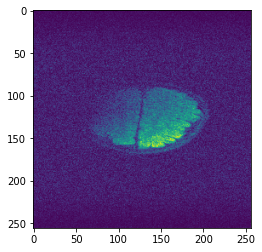

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


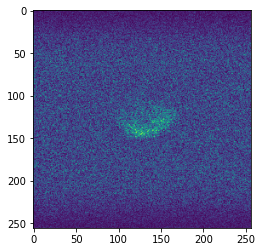

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


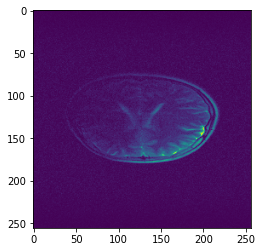

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


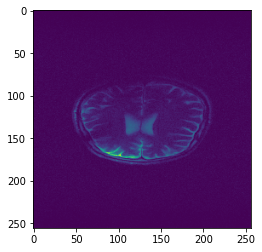

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


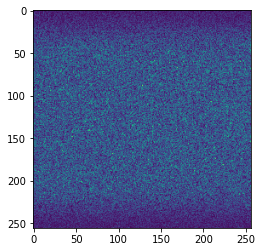

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


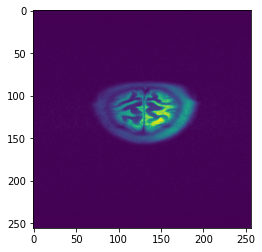

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


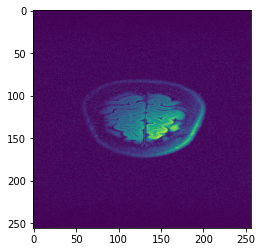

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


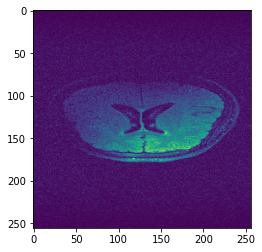

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


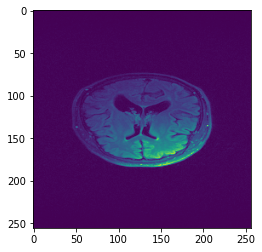

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


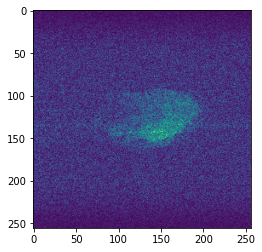

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


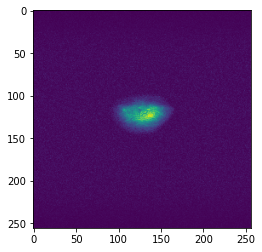

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


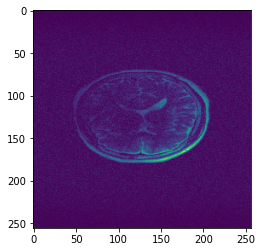

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


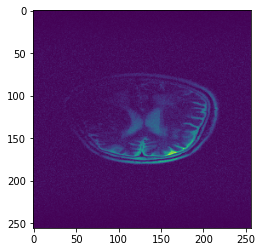

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


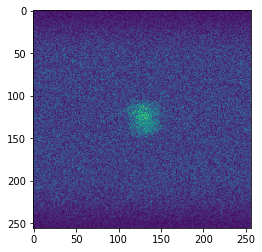

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


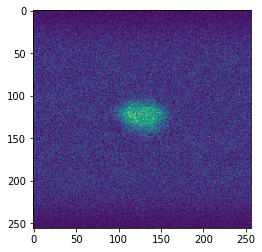

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


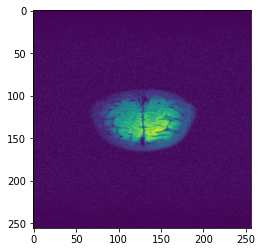

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


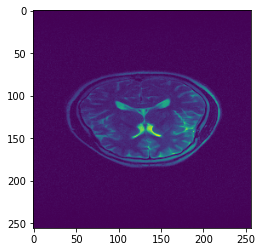

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


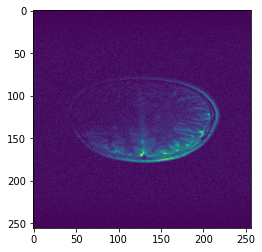

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


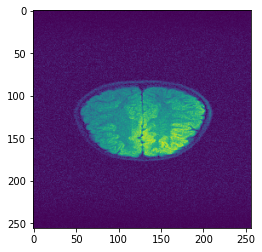

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


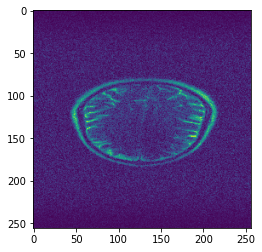

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


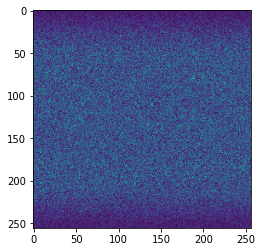

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


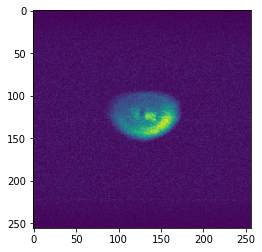

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


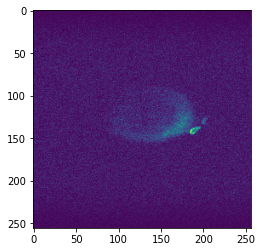

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


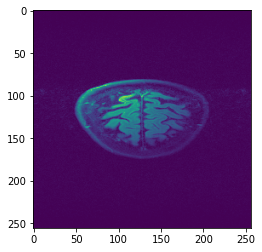

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


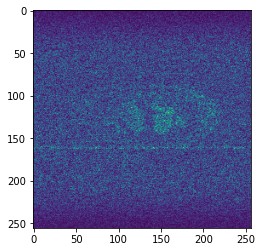

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


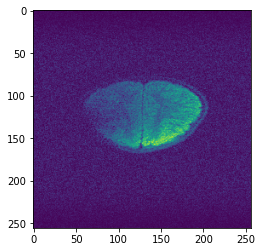

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


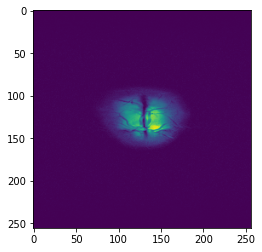

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


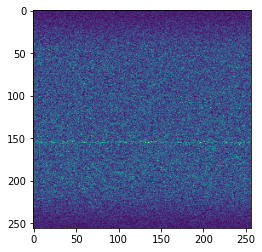

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


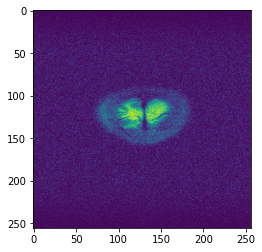

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


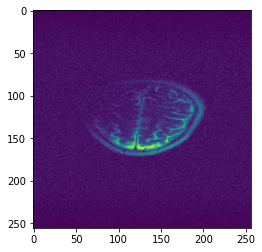

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


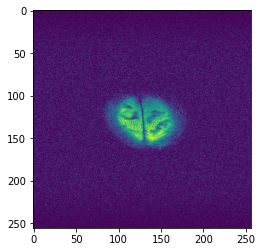

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


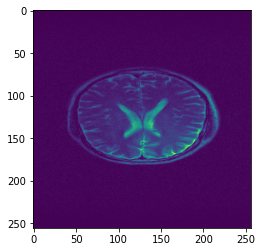

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


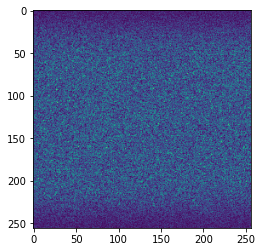

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


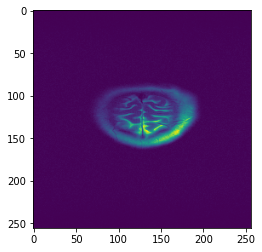

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


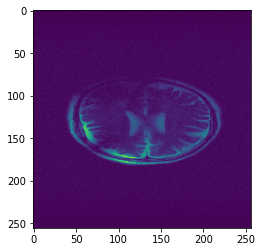

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


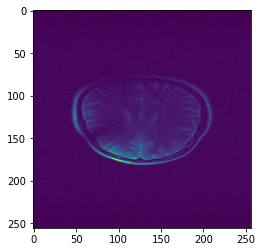

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


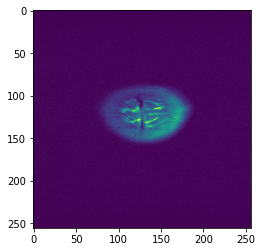

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


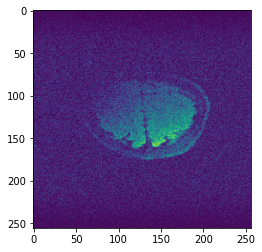

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


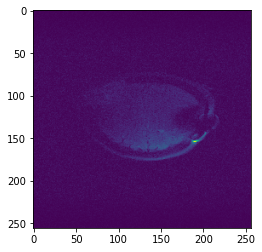

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


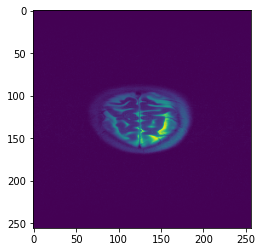

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


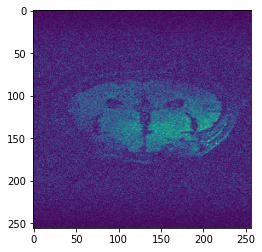

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


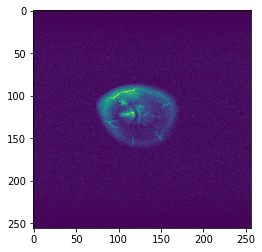

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


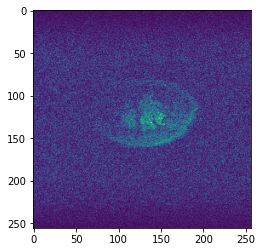

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


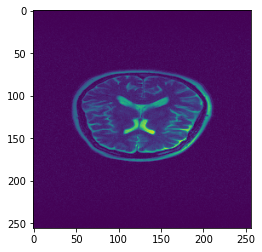

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


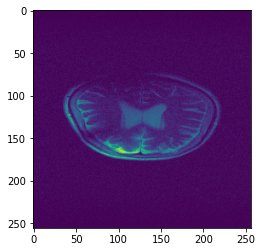

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


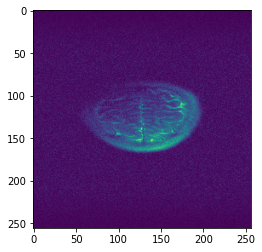

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


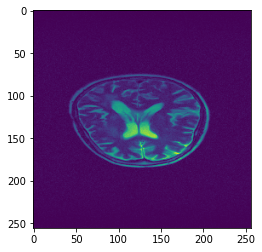

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


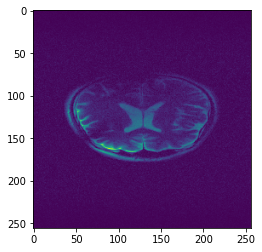

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


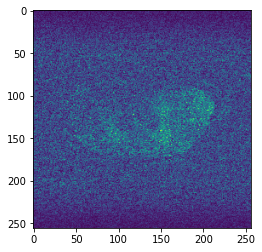

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


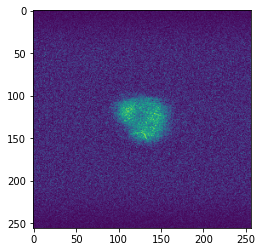

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


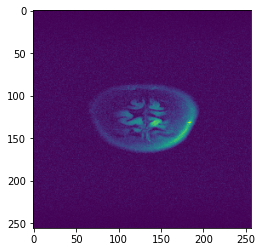

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


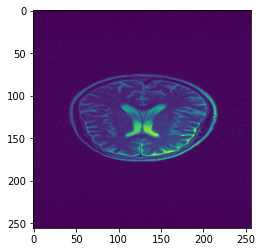

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


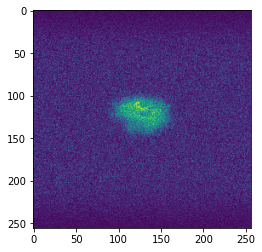

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


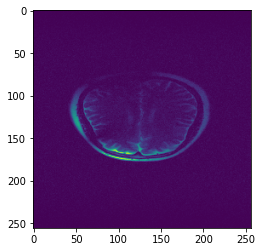

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


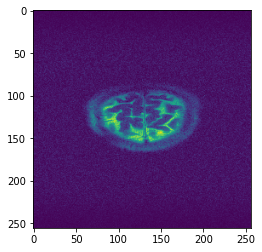

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


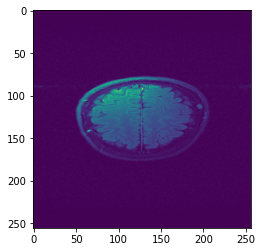

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


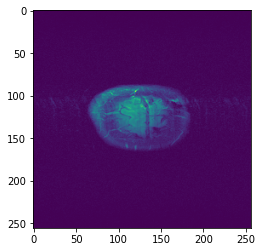

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


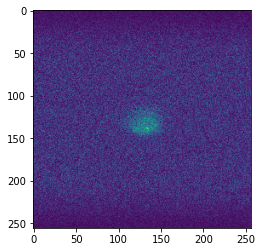

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


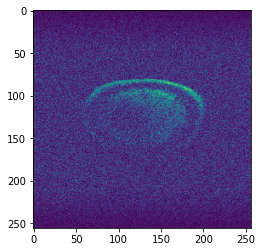

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


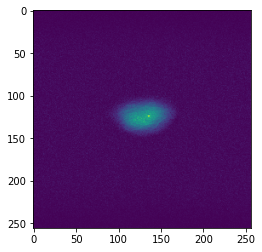

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


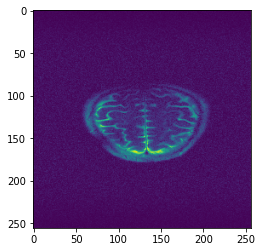

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


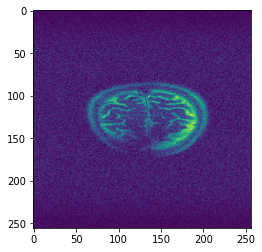

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


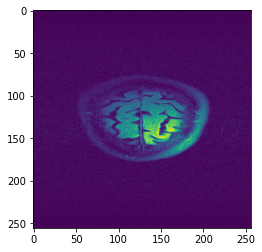

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


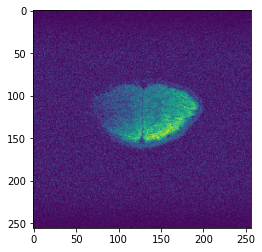

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


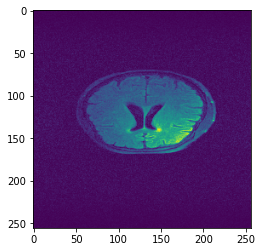

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


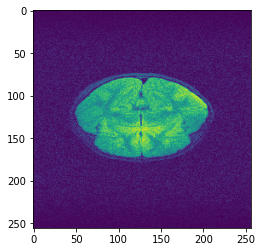

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


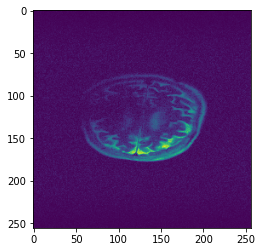

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


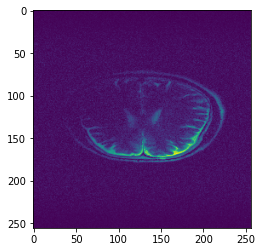

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


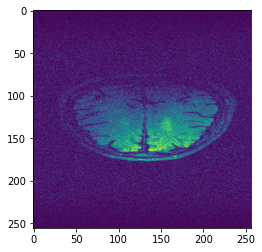

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


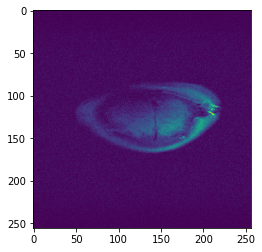

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


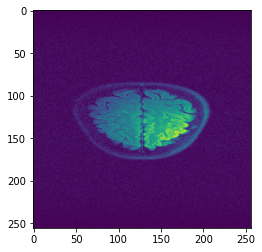

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


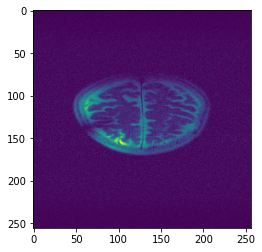

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


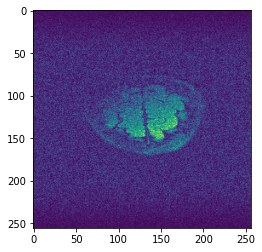

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


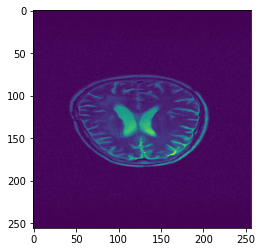

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


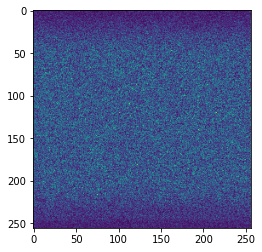

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


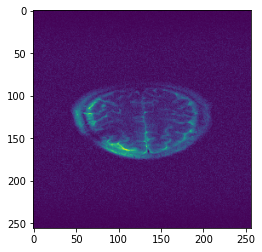

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


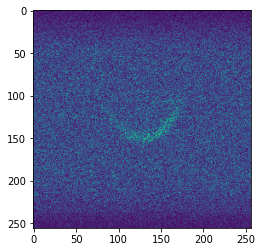

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


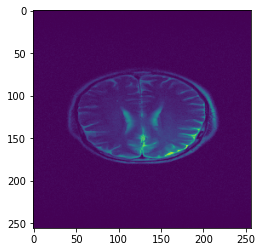

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


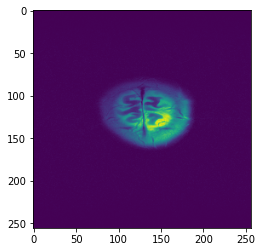

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


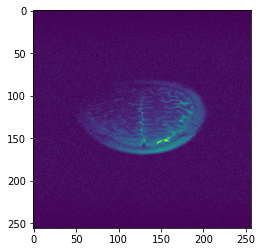

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


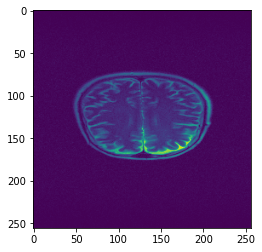

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


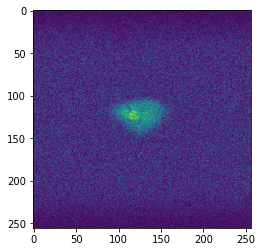

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


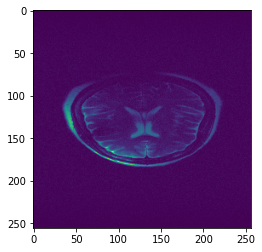

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


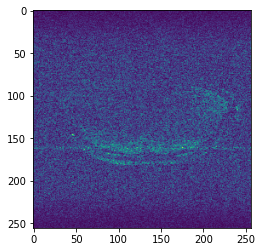

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


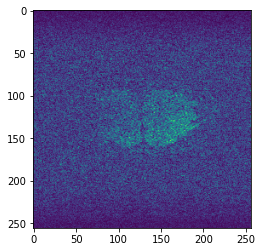

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


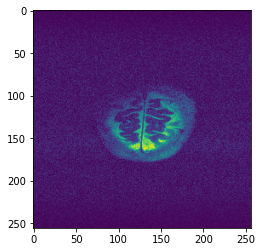

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


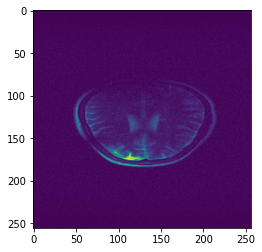

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


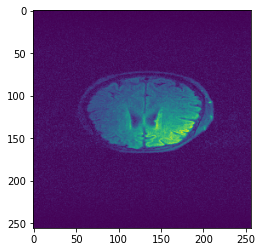

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


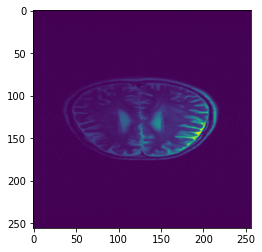

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


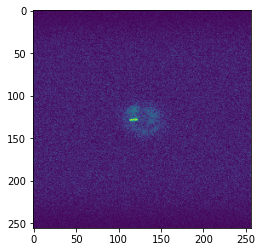

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


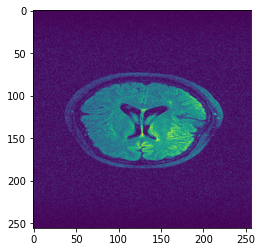

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


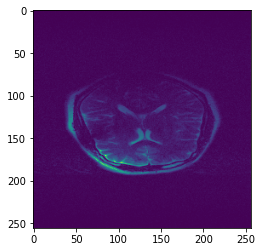

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


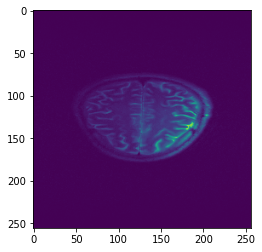

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


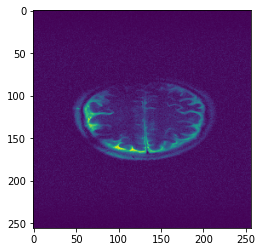

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


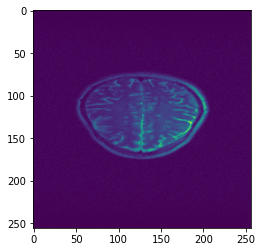

torch.Size([2, 1, 256, 256, 2]) torch.Size([2, 256, 256])


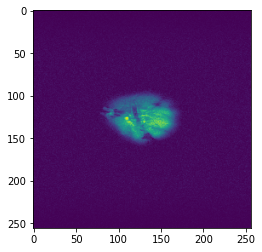

In [6]:
with torch.no_grad():
        for (f, t) in train_loader:
            print(f.shape,t.shape)
            plt.imshow(t[0,:,:])
            plt.show()

In [7]:
def build_model(args,chans=args.num_chans,num_pool_layers=args.num_pools,drop_prob=0.05):
    #check every time which gpus are available!
    #device_ids=[2,3,1]
    device_ids=args.device_ids
    model=UnetModel(in_chans=1,out_chans=1,chans=args.num_chans,num_pool_layers=args.num_pools,drop_prob=args.drop_prob).to(args.device)
    model=model.double()
    if args.data_parallel and args.device=="cuda":
        model = nn.DataParallel(model,device_ids=device_ids)
    print("Model build successfully")
    #vis_weights(model)
    return model

def vis_weights(model):
    for name, param in model.named_parameters():
        if param.requires_grad:
            print(name, param.data)
            # Heat map of neuron weights
            plt.imshow(param.data.cpu(), vmin=np.min(param.data.cpu().numpy()), vmax=np.max(param.data.cpu().numpy()), cmap='coolwarm')
            plt.show()
#            fig,ax=plt.subplots(320,1,figsize=(16,16))
#             for i in range(320):
#                 ax[i].plot(param.data.cpu()[i,:320])
#             plt.show()

def build_optim(args,params):
    optimizer = torch.optim.Adadelta(params)
    return optimizer

def load_model(checkpoint_file,args):
    checkpoint = torch.load(checkpoint_file)
    args = checkpoint['args']
    model = build_model(args)
    model.load_state_dict(checkpoint['model'])

    optimizer = build_optim(args, model.parameters())
    optimizer.load_state_dict(checkpoint['optimizer'])
    print("Model load successfully")
    return checkpoint, model, optimizer

def save_model(args, exp_dir, epoch, model, optimizer, best_dev_loss, is_new_best):
    torch.save(
        {
            'epoch': epoch,
            'args': args,
            'model': model.state_dict(),
            'optimizer': optimizer.state_dict(),
            'best_dev_loss': best_dev_loss,
            'exp_dir': exp_dir
        },
        f=exp_dir / 'model.pt'
    )
    if is_new_best:
        shutil.copyfile(exp_dir / 'model.pt', exp_dir / 'best_model.pt')
        
def visualize(args, epoch, model, data_loader, writer):
    def save_image(image, tag):
        image -= image.min()
        image /= image.max()
        grid = torchvision.utils.make_grid(image, nrow=4, pad_value=1)
        writer.add_image(tag, grid, epoch)
    model.eval()
    
    with torch.no_grad():
        for iter, data in enumerate(data_loader):
            input, target = data
            input = input.unsqueeze(1).to(f'{args.device}:{args.device_ids[0]}')
            target = target.unsqueeze(1).to(f'{args.device}:{args.device_ids[0]}')
            output = model(input)
            save_image(target[0,:,:], 'Target')
            save_image(output[0,:,:], 'Reconstruction')
            save_image(torch.abs(target - output)[0,:,:], 'Error')
            break

In [10]:
def train_epoch(args, epoch, model, data_loader, optimizer, writer):
    model.train()
    avg_loss = 0.
    start_epoch = start_iter = time.perf_counter()
    global_step = epoch * len(data_loader)
    for iter, data in enumerate(data_loader):
        f, t = data
        input = f[:,:,:,:,0].to(f'{args.device}:{model.device_ids[0]}')
        target = t.to(f'{args.device}:{model.device_ids[0]}')
        output = model(input).squeeze(1)
        
        loss = F.mse_loss(output, target)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        avg_loss = 0.99 * avg_loss + 0.01 * loss.item() if iter > 0 else loss.item()
        writer.add_scalar('TrainLoss', loss.item(), global_step + iter)

#         if iter % args.report_interval == 0:
#             print(f'Epoch = [{epoch:3d}/{args.num_epochs:3d}] ',
#                 f'Iter = [{iter:4d}/{len(data_loader):4d}] ',
#                 f'Loss = {loss.item():.4g} Avg Loss = {avg_loss:.4g} ',
#                 f'Time = {time.perf_counter() - start_iter:.4f}s')
#             logging.info(
#                 f'Epoch = [{epoch:3d}/{args.num_epochs:3d}] '
#                 f'Iter = [{iter:4d}/{len(data_loader):4d}] '
#                 f'Loss = {loss.item():.4g} Avg Loss = {avg_loss:.4g} '
#                 f'Time = {time.perf_counter() - start_iter:.4f}s',
#             )
        start_iter = time.perf_counter()
    return avg_loss, time.perf_counter() - start_epoch

def evaluate(args, epoch, model, data_loader, writer):
    model.eval()
    losses = []
    start = time.perf_counter()
    with torch.no_grad():
        for iter, data in enumerate(data_loader):
            f, t = data
            input = f[:,:,:,:,0].to(f'{args.device}:{model.device_ids[0]}')
            target = t.to(f'{args.device}:{model.device_ids[0]}')
            output = model(input).squeeze(1)

            #mean = mean.unsqueeze(1).unsqueeze(2).to(args.device)
            #std = std.unsqueeze(1).unsqueeze(2).to(args.device)
            #target = target * std + mean
            #output = output * std + mean

            #norm = norm.unsqueeze(1).unsqueeze(2).to(args.device)
            #loss = F.mse_loss(output / norm, target / norm, size_average=False)
            loss = F.mse_loss(output, target)
            losses.append(loss.item())
        writer.add_scalar('Dev_Loss', np.mean(losses), epoch)
        print('Dev_Loss', np.mean(losses),'Epoch', epoch)
    return np.mean(losses), time.perf_counter() - start

Model build successfully
Dev_Loss 0.010406596681833163 Epoch 0
Epoch = [   0/ 250] TrainLoss = 0.04513  DevLoss = 0.01041 TrainTime = 272.1999s DevTime = 97.6988s


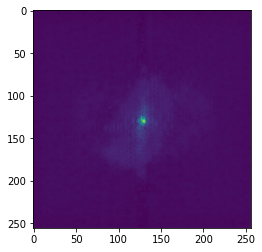

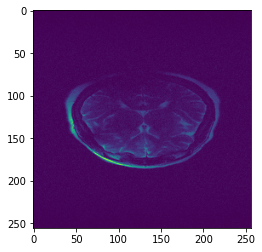

Time taken for epoch:  371.4499270915985
Dev_Loss 0.013561462527098162 Epoch 1
Epoch = [   1/ 250] TrainLoss = 0.009756  DevLoss = 0.01356 TrainTime = 275.9471s DevTime = 94.8311s


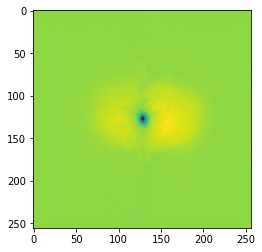

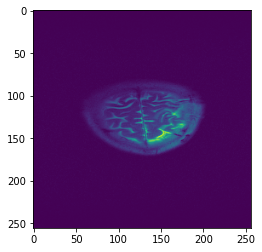

Time taken for epoch:  372.17756724357605
Dev_Loss 0.008694227222242277 Epoch 2
Epoch = [   2/ 250] TrainLoss = 0.0104  DevLoss = 0.008694 TrainTime = 275.9229s DevTime = 94.9114s


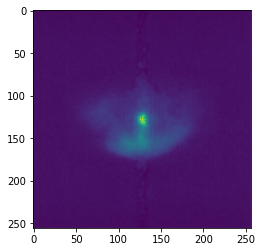

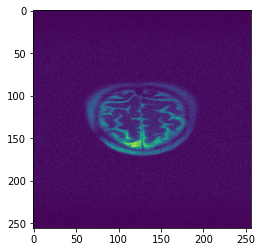

Time taken for epoch:  373.64735198020935
Dev_Loss 0.009968164868932637 Epoch 3
Epoch = [   3/ 250] TrainLoss = 0.008668  DevLoss = 0.009968 TrainTime = 276.7500s DevTime = 94.8851s


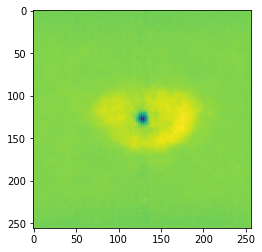

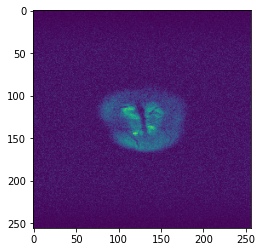

Time taken for epoch:  373.1529104709625
Dev_Loss 0.008207031613533195 Epoch 4
Epoch = [   4/ 250] TrainLoss = 0.01032  DevLoss = 0.008207 TrainTime = 277.1145s DevTime = 94.7414s


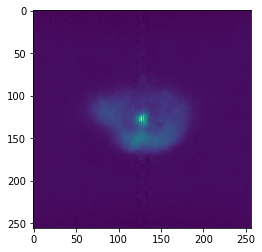

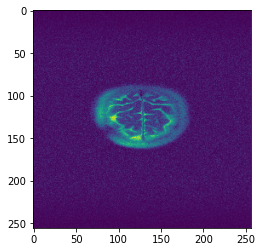

Time taken for epoch:  375.7984812259674
Dev_Loss 0.012288679264150093 Epoch 5
Epoch = [   5/ 250] TrainLoss = 0.007828  DevLoss = 0.01229 TrainTime = 375.1204s DevTime = 94.5248s


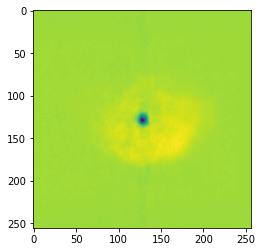

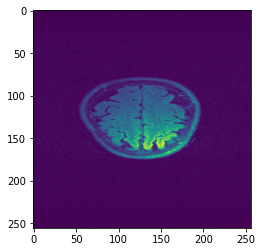

Time taken for epoch:  471.2289192676544
Dev_Loss 0.007654977830393813 Epoch 6
Epoch = [   6/ 250] TrainLoss = 0.007962  DevLoss = 0.007655 TrainTime = 274.2854s DevTime = 94.3817s


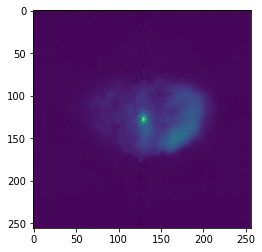

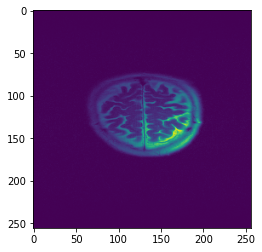

Time taken for epoch:  372.1741099357605
Dev_Loss 0.011644515545382081 Epoch 7
Epoch = [   7/ 250] TrainLoss = 0.007319  DevLoss = 0.01164 TrainTime = 274.4115s DevTime = 94.3016s


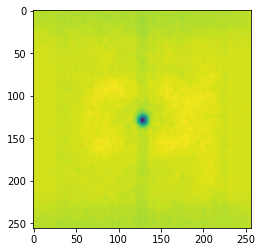

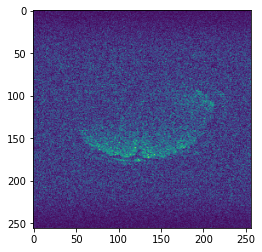

Time taken for epoch:  370.1250705718994
Dev_Loss 0.008590562320989726 Epoch 8
Epoch = [   8/ 250] TrainLoss = 0.007993  DevLoss = 0.008591 TrainTime = 275.1555s DevTime = 94.5369s


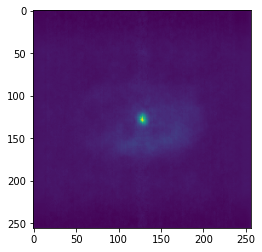

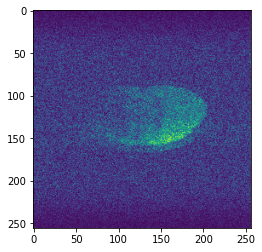

Time taken for epoch:  371.21882224082947
Dev_Loss 0.008712537280140499 Epoch 9
Epoch = [   9/ 250] TrainLoss = 0.006565  DevLoss = 0.008713 TrainTime = 326.9973s DevTime = 180.7322s


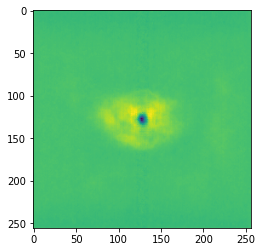

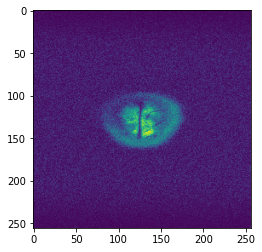

Time taken for epoch:  509.25434970855713
Dev_Loss 0.006892588520401378 Epoch 10
Epoch = [  10/ 250] TrainLoss = 0.006965  DevLoss = 0.006893 TrainTime = 274.1381s DevTime = 94.7401s


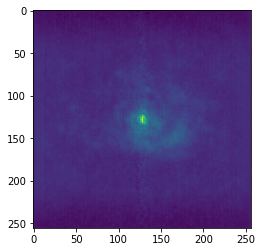

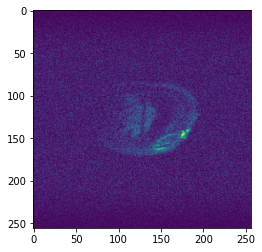

Time taken for epoch:  371.8711597919464
Dev_Loss 0.008028528537116525 Epoch 11
Epoch = [  11/ 250] TrainLoss = 0.005777  DevLoss = 0.008029 TrainTime = 274.4699s DevTime = 94.4758s


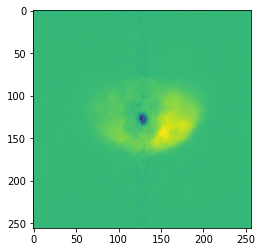

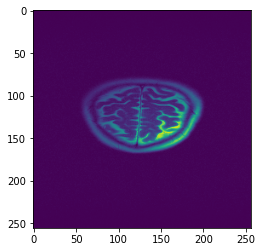

Time taken for epoch:  370.5654499530792
Dev_Loss 0.00876120430318299 Epoch 12
Epoch = [  12/ 250] TrainLoss = 0.005544  DevLoss = 0.008761 TrainTime = 274.3688s DevTime = 94.8377s


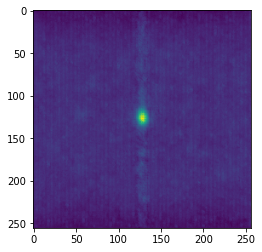

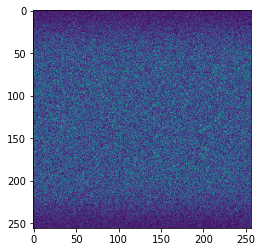

Time taken for epoch:  370.87117409706116
Dev_Loss 0.008354243284825957 Epoch 13
Epoch = [  13/ 250] TrainLoss = 0.005129  DevLoss = 0.008354 TrainTime = 274.2921s DevTime = 94.2355s


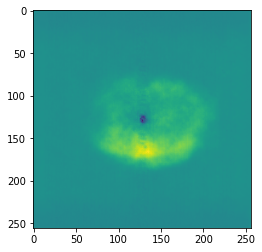

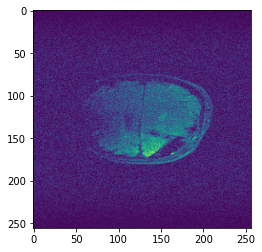

Time taken for epoch:  369.87066888809204
Dev_Loss 0.007062935285344412 Epoch 14
Epoch = [  14/ 250] TrainLoss = 0.004987  DevLoss = 0.007063 TrainTime = 274.2205s DevTime = 93.5202s


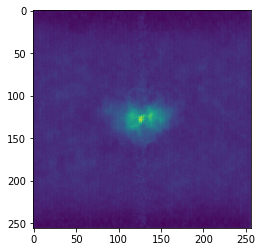

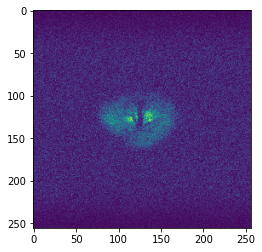

Time taken for epoch:  369.3172056674957
Dev_Loss 0.006413115894098085 Epoch 15
Epoch = [  15/ 250] TrainLoss = 0.004685  DevLoss = 0.006413 TrainTime = 274.1565s DevTime = 93.4131s


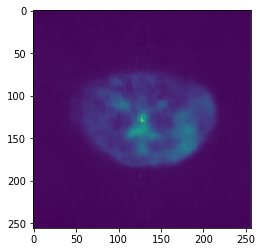

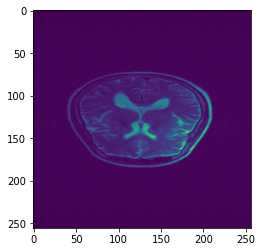

Time taken for epoch:  370.4578676223755
Dev_Loss 0.006317392147019301 Epoch 16
Epoch = [  16/ 250] TrainLoss = 0.004405  DevLoss = 0.006317 TrainTime = 274.0534s DevTime = 93.3705s


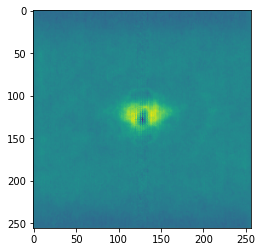

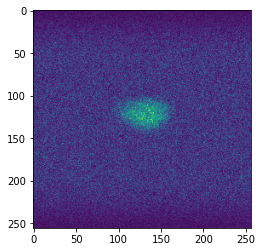

Time taken for epoch:  370.7468476295471
Dev_Loss 0.0070537540698806635 Epoch 17
Epoch = [  17/ 250] TrainLoss = 0.004625  DevLoss = 0.007054 TrainTime = 273.8524s DevTime = 93.5374s


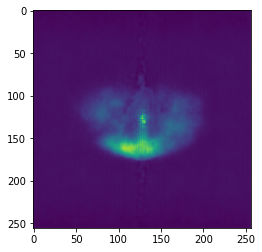

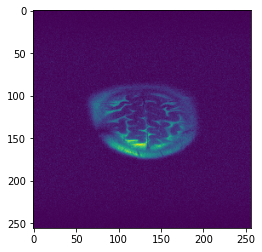

Time taken for epoch:  368.68318247795105
Dev_Loss 0.009625455699618762 Epoch 18
Epoch = [  18/ 250] TrainLoss = 0.004572  DevLoss = 0.009625 TrainTime = 274.1423s DevTime = 93.4221s


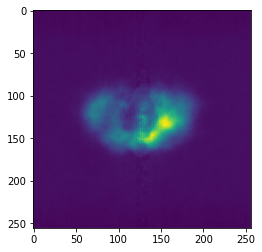

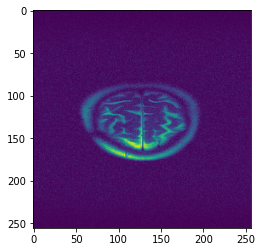

Time taken for epoch:  368.95052552223206
Dev_Loss 0.00699415651050111 Epoch 19
Epoch = [  19/ 250] TrainLoss = 0.005324  DevLoss = 0.006994 TrainTime = 273.5240s DevTime = 93.2323s


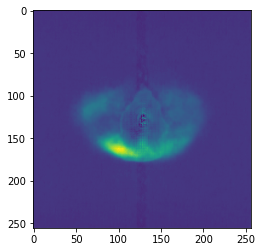

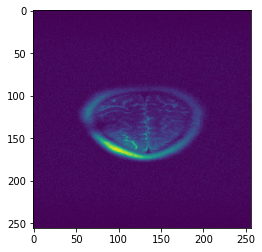

Time taken for epoch:  368.0510210990906
Dev_Loss 0.008525666501713037 Epoch 20
Epoch = [  20/ 250] TrainLoss = 0.004348  DevLoss = 0.008526 TrainTime = 274.2875s DevTime = 93.5490s


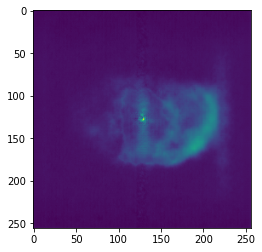

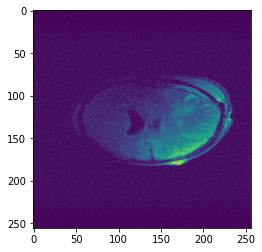

Time taken for epoch:  369.18887639045715
Dev_Loss 0.008020655911280747 Epoch 21
Epoch = [  21/ 250] TrainLoss = 0.004589  DevLoss = 0.008021 TrainTime = 273.9099s DevTime = 93.4408s


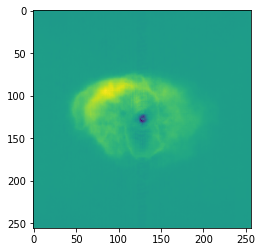

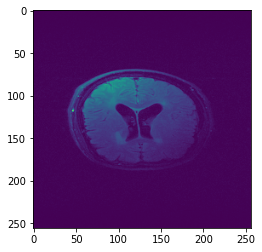

Time taken for epoch:  368.7378125190735
Dev_Loss 0.008863046076011993 Epoch 22
Epoch = [  22/ 250] TrainLoss = 0.004304  DevLoss = 0.008863 TrainTime = 308.8687s DevTime = 202.4264s


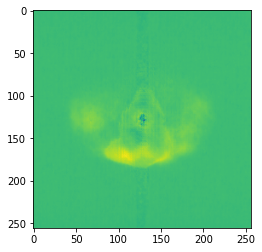

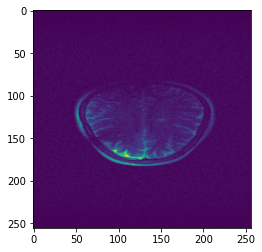

Time taken for epoch:  513.3158457279205
Dev_Loss 0.006334424394748182 Epoch 23
Epoch = [  23/ 250] TrainLoss = 0.004505  DevLoss = 0.006334 TrainTime = 279.7157s DevTime = 93.2917s


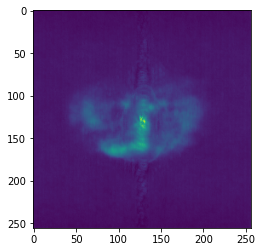

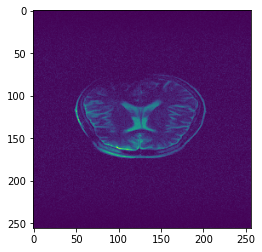

Time taken for epoch:  374.2934818267822
Dev_Loss 0.00672100067406112 Epoch 24
Epoch = [  24/ 250] TrainLoss = 0.004268  DevLoss = 0.006721 TrainTime = 274.3784s DevTime = 93.4361s


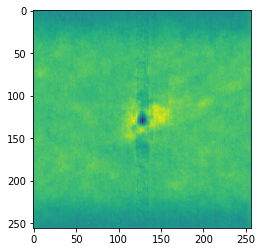

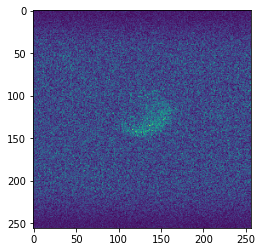

Time taken for epoch:  369.130921125412
Dev_Loss 0.007207705878730106 Epoch 25
Epoch = [  25/ 250] TrainLoss = 0.004242  DevLoss = 0.007208 TrainTime = 273.9416s DevTime = 93.4493s


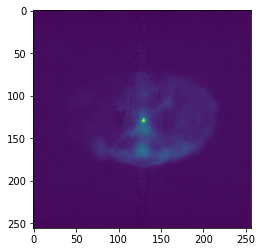

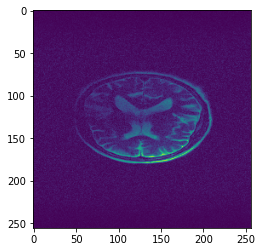

Time taken for epoch:  368.68327140808105
Dev_Loss 0.006669375009628251 Epoch 26
Epoch = [  26/ 250] TrainLoss = 0.004447  DevLoss = 0.006669 TrainTime = 277.5999s DevTime = 97.1185s


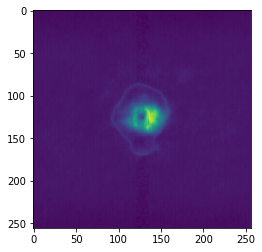

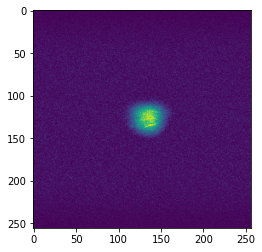

Time taken for epoch:  376.37653708457947
Dev_Loss 0.008139326514011544 Epoch 27
Epoch = [  27/ 250] TrainLoss = 0.004195  DevLoss = 0.008139 TrainTime = 277.2070s DevTime = 98.3367s


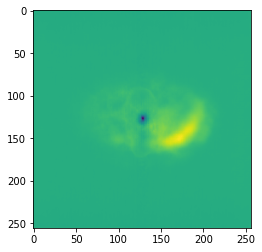

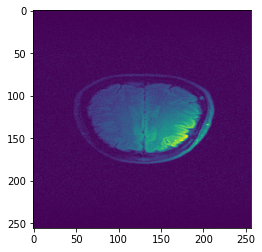

Time taken for epoch:  377.8218774795532
Dev_Loss 0.006398270096846318 Epoch 28
Epoch = [  28/ 250] TrainLoss = 0.004863  DevLoss = 0.006398 TrainTime = 280.7699s DevTime = 93.6945s


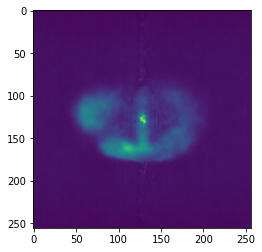

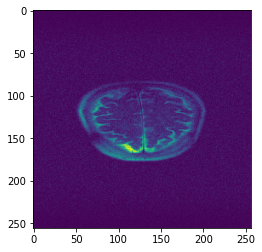

Time taken for epoch:  376.0625867843628
Dev_Loss 0.006348657987168695 Epoch 29
Epoch = [  29/ 250] TrainLoss = 0.004104  DevLoss = 0.006349 TrainTime = 343.5854s DevTime = 98.9048s


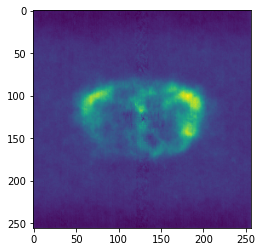

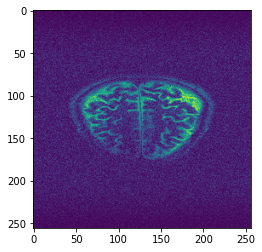

Time taken for epoch:  443.7810742855072
Dev_Loss 0.007224950368935267 Epoch 30
Epoch = [  30/ 250] TrainLoss = 0.003944  DevLoss = 0.007225 TrainTime = 274.3693s DevTime = 156.9718s


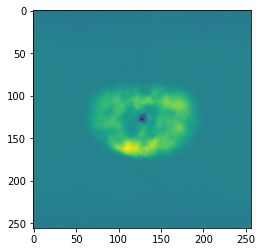

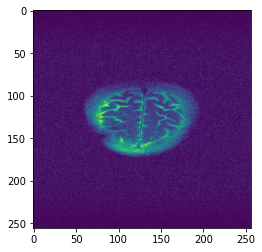

Time taken for epoch:  433.73887610435486
Dev_Loss 0.008481947010320406 Epoch 31
Epoch = [  31/ 250] TrainLoss = 0.00423  DevLoss = 0.008482 TrainTime = 382.7494s DevTime = 201.4070s


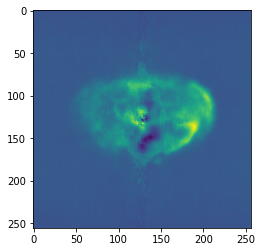

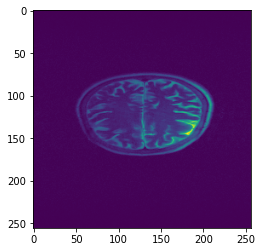

Time taken for epoch:  586.4488844871521
Dev_Loss 0.006603579320101043 Epoch 32
Epoch = [  32/ 250] TrainLoss = 0.004417  DevLoss = 0.006604 TrainTime = 385.4648s DevTime = 196.8825s


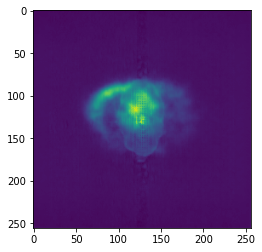

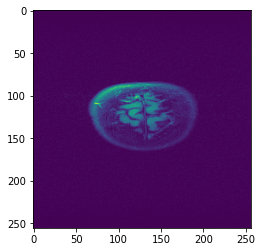

Time taken for epoch:  584.4613997936249
Dev_Loss 0.009111715869796479 Epoch 33
Epoch = [  33/ 250] TrainLoss = 0.003758  DevLoss = 0.009112 TrainTime = 373.7236s DevTime = 202.5624s


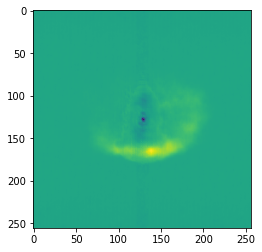

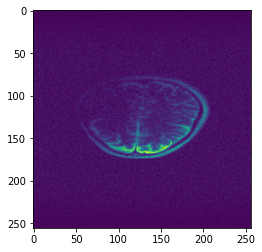

Time taken for epoch:  578.6139314174652
Dev_Loss 0.00626620579006088 Epoch 34
Epoch = [  34/ 250] TrainLoss = 0.004034  DevLoss = 0.006266 TrainTime = 323.9189s DevTime = 95.8732s


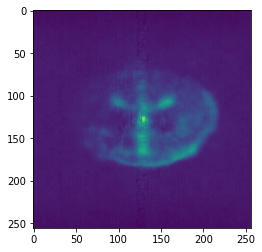

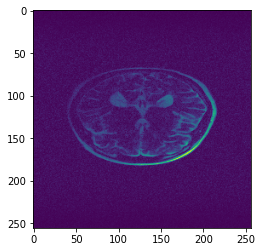

Time taken for epoch:  423.03504395484924
Dev_Loss 0.008129611984053 Epoch 35
Epoch = [  35/ 250] TrainLoss = 0.004008  DevLoss = 0.00813 TrainTime = 276.3052s DevTime = 93.7101s


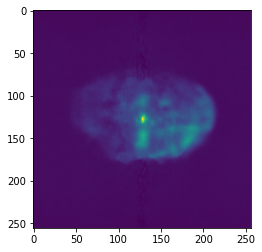

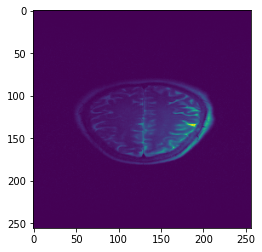

Time taken for epoch:  371.85841727256775
Dev_Loss 0.007319915226777081 Epoch 36
Epoch = [  36/ 250] TrainLoss = 0.004063  DevLoss = 0.00732 TrainTime = 272.9693s DevTime = 93.6462s


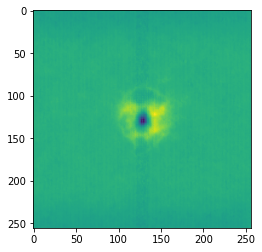

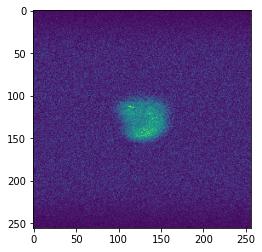

Time taken for epoch:  368.5591974258423
Dev_Loss 0.006331298893738335 Epoch 37
Epoch = [  37/ 250] TrainLoss = 0.004145  DevLoss = 0.006331 TrainTime = 271.9254s DevTime = 93.4249s


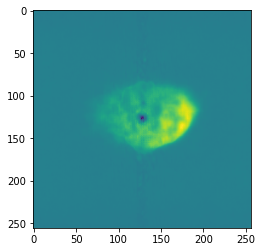

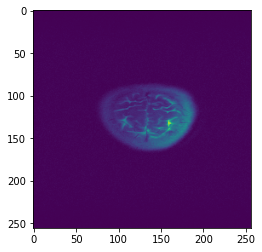

Time taken for epoch:  367.21151304244995
Dev_Loss 0.006200525168712626 Epoch 38
Epoch = [  38/ 250] TrainLoss = 0.003917  DevLoss = 0.006201 TrainTime = 272.3294s DevTime = 93.7040s


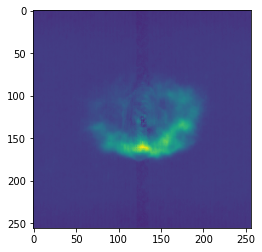

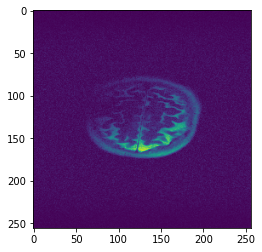

Time taken for epoch:  368.9191253185272
Dev_Loss 0.008269974269616225 Epoch 39
Epoch = [  39/ 250] TrainLoss = 0.003803  DevLoss = 0.00827 TrainTime = 272.0056s DevTime = 93.5454s


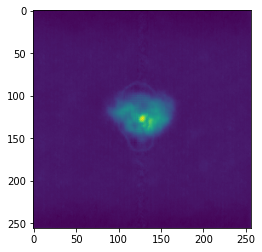

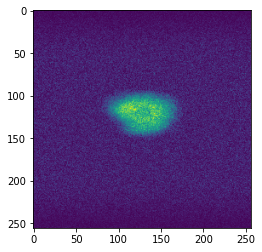

Time taken for epoch:  367.48904752731323
Dev_Loss 0.007511536902311142 Epoch 40
Epoch = [  40/ 250] TrainLoss = 0.00383  DevLoss = 0.007512 TrainTime = 273.0613s DevTime = 93.3734s


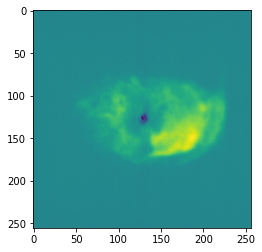

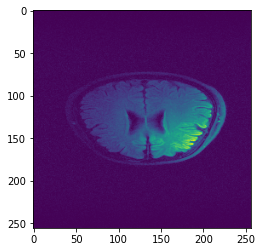

Time taken for epoch:  368.3126759529114
Dev_Loss 0.007322904428307096 Epoch 41
Epoch = [  41/ 250] TrainLoss = 0.004033  DevLoss = 0.007323 TrainTime = 272.4388s DevTime = 93.7957s


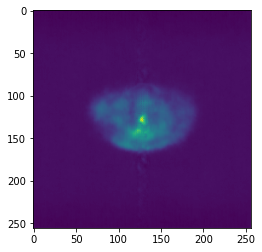

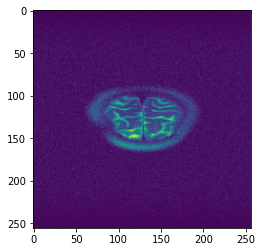

Time taken for epoch:  368.04556488990784
Dev_Loss 0.00694862486976332 Epoch 42
Epoch = [  42/ 250] TrainLoss = 0.003741  DevLoss = 0.006949 TrainTime = 272.4514s DevTime = 93.6088s


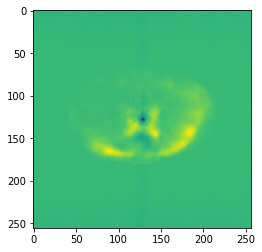

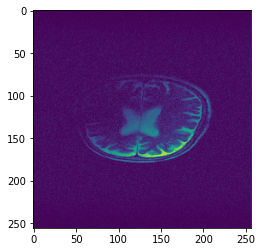

Time taken for epoch:  368.0701735019684
Dev_Loss 0.006591832827401608 Epoch 43
Epoch = [  43/ 250] TrainLoss = 0.004073  DevLoss = 0.006592 TrainTime = 274.2110s DevTime = 93.5247s


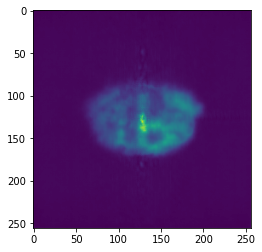

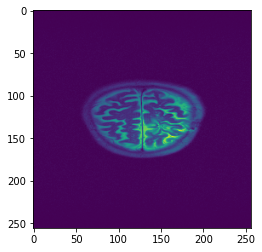

Time taken for epoch:  369.5807092189789
Dev_Loss 0.006400644832005283 Epoch 44
Epoch = [  44/ 250] TrainLoss = 0.003766  DevLoss = 0.006401 TrainTime = 272.5532s DevTime = 93.5709s


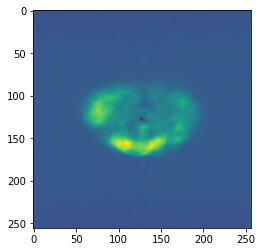

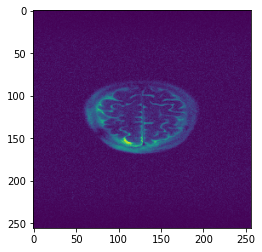

Time taken for epoch:  368.00364542007446
Dev_Loss 0.0072557752786761185 Epoch 45
Epoch = [  45/ 250] TrainLoss = 0.003469  DevLoss = 0.007256 TrainTime = 273.2193s DevTime = 93.3495s


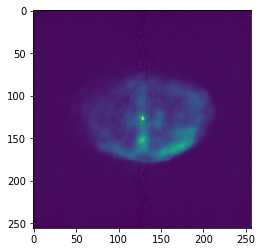

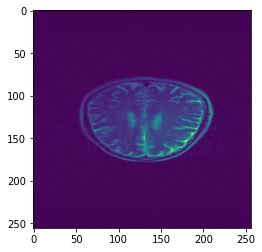

Time taken for epoch:  368.60245394706726
Dev_Loss 0.007090033483608983 Epoch 46
Epoch = [  46/ 250] TrainLoss = 0.00393  DevLoss = 0.00709 TrainTime = 273.7250s DevTime = 93.5610s


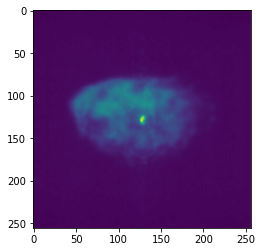

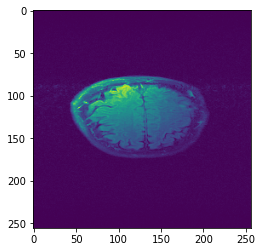

Time taken for epoch:  369.1436507701874
Dev_Loss 0.006636535946523869 Epoch 47
Epoch = [  47/ 250] TrainLoss = 0.003856  DevLoss = 0.006637 TrainTime = 273.6181s DevTime = 93.5126s


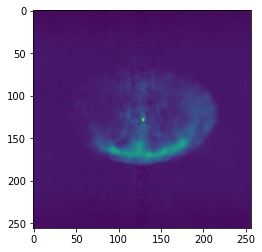

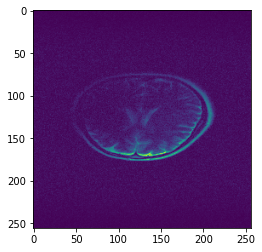

Time taken for epoch:  369.0092496871948
Dev_Loss 0.0071618511579671805 Epoch 48
Epoch = [  48/ 250] TrainLoss = 0.003557  DevLoss = 0.007162 TrainTime = 273.1550s DevTime = 93.3117s


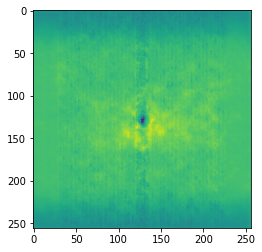

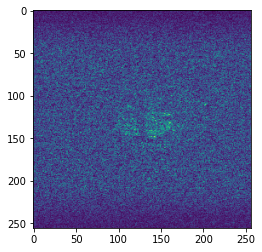

Time taken for epoch:  368.45440888404846
Dev_Loss 0.008000759219364799 Epoch 49
Epoch = [  49/ 250] TrainLoss = 0.003801  DevLoss = 0.008001 TrainTime = 273.5400s DevTime = 93.5392s


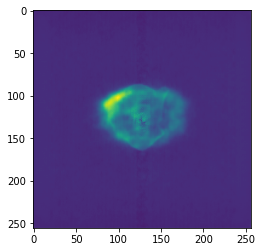

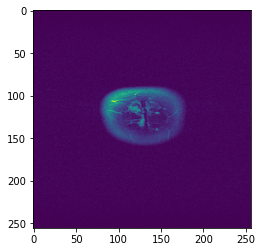

Time taken for epoch:  368.93952655792236
Dev_Loss 0.00651940989217221 Epoch 50
Epoch = [  50/ 250] TrainLoss = 0.003504  DevLoss = 0.006519 TrainTime = 274.1129s DevTime = 93.5262s


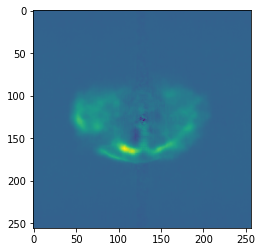

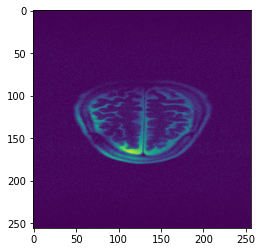

Time taken for epoch:  369.4881148338318
Dev_Loss 0.007737319255170492 Epoch 51
Epoch = [  51/ 250] TrainLoss = 0.003459  DevLoss = 0.007737 TrainTime = 273.7910s DevTime = 93.6354s


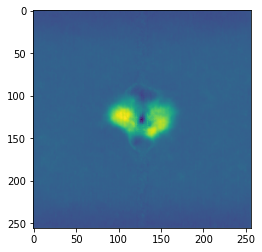

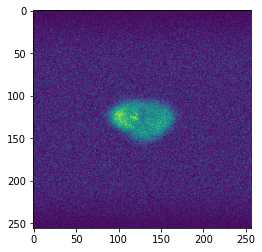

Time taken for epoch:  369.39147567749023
Dev_Loss 0.0070756642677616815 Epoch 52
Epoch = [  52/ 250] TrainLoss = 0.004132  DevLoss = 0.007076 TrainTime = 274.0994s DevTime = 93.4550s


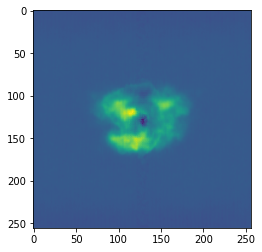

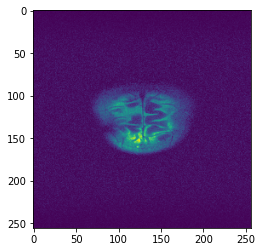

Time taken for epoch:  369.527720451355
Dev_Loss 0.006765769850387266 Epoch 53
Epoch = [  53/ 250] TrainLoss = 0.003313  DevLoss = 0.006766 TrainTime = 273.7672s DevTime = 93.8563s


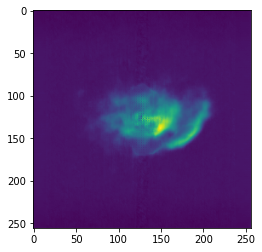

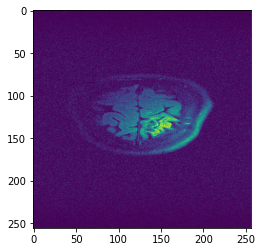

Time taken for epoch:  369.4262170791626
Dev_Loss 0.006858818234352439 Epoch 54
Epoch = [  54/ 250] TrainLoss = 0.003473  DevLoss = 0.006859 TrainTime = 274.0267s DevTime = 93.6505s


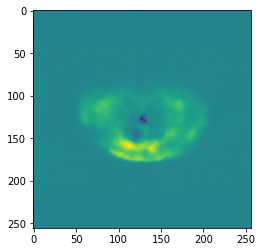

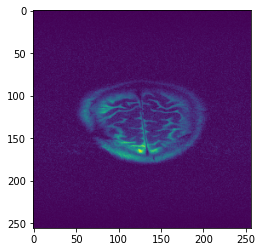

Time taken for epoch:  369.6534547805786
Dev_Loss 0.0072162300804051414 Epoch 55
Epoch = [  55/ 250] TrainLoss = 0.003469  DevLoss = 0.007216 TrainTime = 273.6585s DevTime = 93.7667s


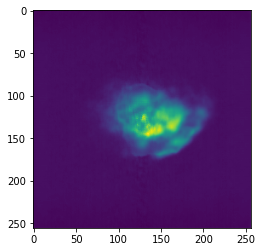

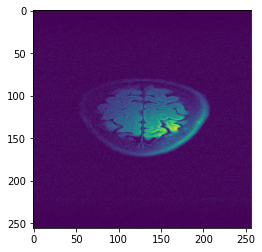

Time taken for epoch:  369.2933609485626
Dev_Loss 0.00672752308078122 Epoch 56
Epoch = [  56/ 250] TrainLoss = 0.003821  DevLoss = 0.006728 TrainTime = 273.7935s DevTime = 93.4520s


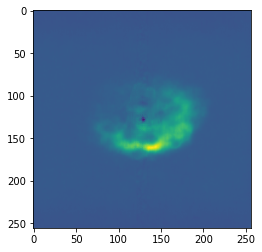

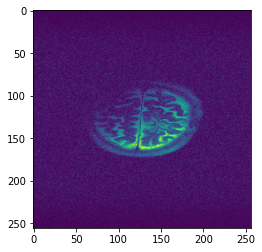

Time taken for epoch:  369.2088704109192
Dev_Loss 0.006735564988357129 Epoch 57
Epoch = [  57/ 250] TrainLoss = 0.003439  DevLoss = 0.006736 TrainTime = 273.9476s DevTime = 93.7464s


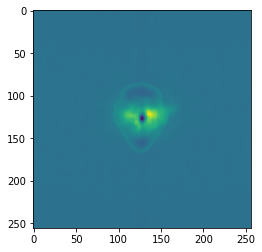

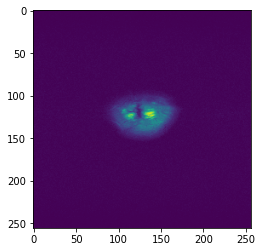

Time taken for epoch:  369.64562916755676
Dev_Loss 0.00628543622647198 Epoch 58
Epoch = [  58/ 250] TrainLoss = 0.003602  DevLoss = 0.006285 TrainTime = 273.5287s DevTime = 93.3391s


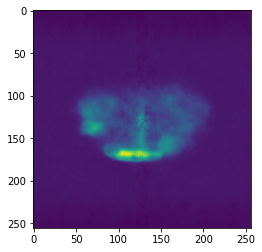

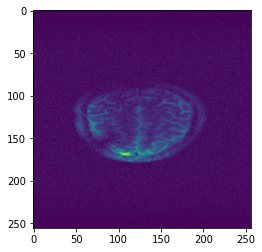

Time taken for epoch:  368.7574543952942
Dev_Loss 0.0069171140897775485 Epoch 59
Epoch = [  59/ 250] TrainLoss = 0.003474  DevLoss = 0.006917 TrainTime = 274.3899s DevTime = 94.2165s


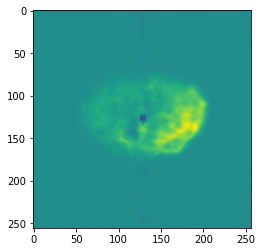

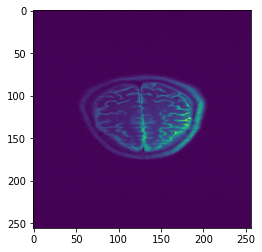

Time taken for epoch:  370.3621804714203
Dev_Loss 0.0064756539332076115 Epoch 60
Epoch = [  60/ 250] TrainLoss = 0.003433  DevLoss = 0.006476 TrainTime = 283.1562s DevTime = 132.2852s


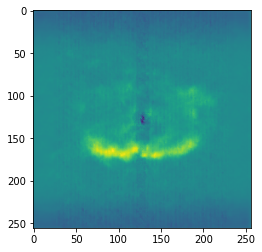

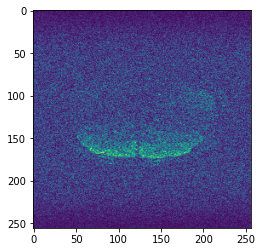

Time taken for epoch:  417.4315457344055
Dev_Loss 0.007057223834842538 Epoch 61
Epoch = [  61/ 250] TrainLoss = 0.003278  DevLoss = 0.007057 TrainTime = 310.6449s DevTime = 94.9584s


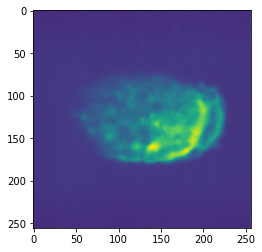

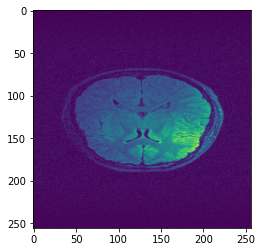

Time taken for epoch:  407.5955505371094
Dev_Loss 0.006829026105113966 Epoch 62
Epoch = [  62/ 250] TrainLoss = 0.003376  DevLoss = 0.006829 TrainTime = 281.8679s DevTime = 123.3427s


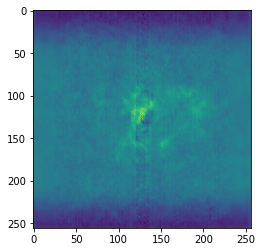

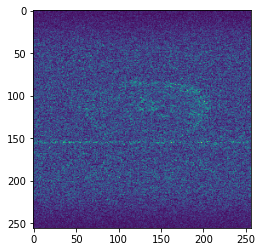

Time taken for epoch:  407.364305973053
Dev_Loss 0.006940137745161422 Epoch 63
Epoch = [  63/ 250] TrainLoss = 0.003372  DevLoss = 0.00694 TrainTime = 331.9803s DevTime = 96.4541s


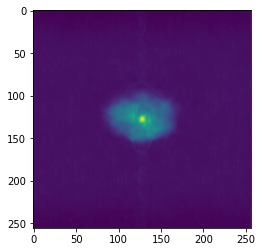

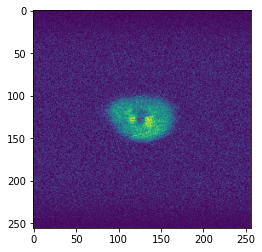

Time taken for epoch:  430.40378165245056
Dev_Loss 0.006241681238968121 Epoch 64
Epoch = [  64/ 250] TrainLoss = 0.003381  DevLoss = 0.006242 TrainTime = 275.6420s DevTime = 94.4318s


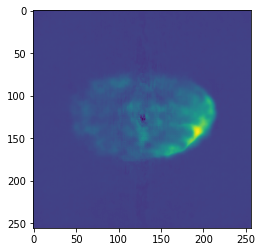

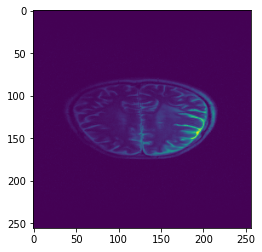

Time taken for epoch:  371.85928225517273
Dev_Loss 0.006449187087311079 Epoch 65
Epoch = [  65/ 250] TrainLoss = 0.003152  DevLoss = 0.006449 TrainTime = 273.9652s DevTime = 93.3596s


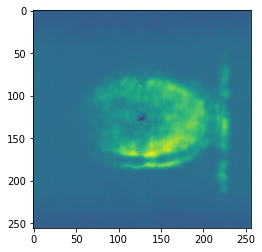

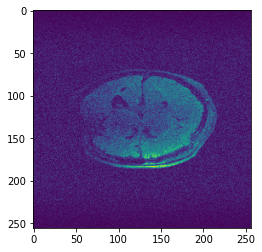

Time taken for epoch:  369.35324573516846
Dev_Loss 0.006658545857232999 Epoch 66
Epoch = [  66/ 250] TrainLoss = 0.003469  DevLoss = 0.006659 TrainTime = 274.2548s DevTime = 93.4160s


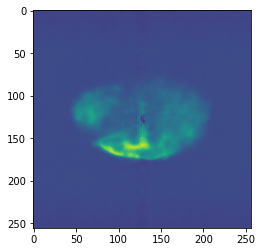

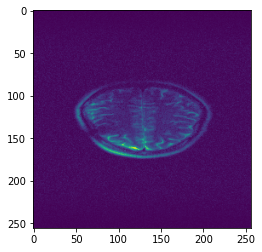

Time taken for epoch:  369.86628675460815
Dev_Loss 0.007087757395870692 Epoch 67
Epoch = [  67/ 250] TrainLoss = 0.003276  DevLoss = 0.007088 TrainTime = 275.1021s DevTime = 93.5082s


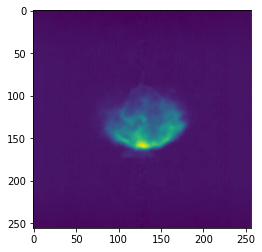

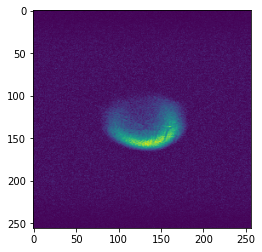

Time taken for epoch:  370.57298469543457
Dev_Loss 0.007000768483734113 Epoch 68
Epoch = [  68/ 250] TrainLoss = 0.003619  DevLoss = 0.007001 TrainTime = 275.0361s DevTime = 94.8153s


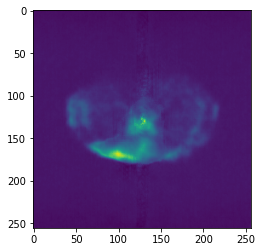

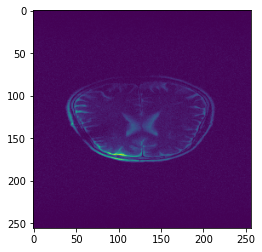

Time taken for epoch:  372.02539110183716


In [ ]:
def train(args): 
    args.exp_dir.mkdir(parents=True, exist_ok=True)
    writer = SummaryWriter(logdir=str(args.logdir)) #log directory for run

    if args.resume: #be aware of the option
        checkpoint, model, optimizer = load_model(args.checkpoint,args)
        args = checkpoint['args']
        best_dev_loss = checkpoint['best_dev_loss']
        #start_epoch = checkpoint['epoch']
        start_epoch = 0
        del checkpoint
    else:
        model = build_model(args)
        optimizer = build_optim(args, model.parameters())
        best_dev_loss = 1e9
        start_epoch = 0
    logging.info(args)
    logging.info(model)

    #train_loader,dev_loader,test_loader = create_data_loaders()
    scheduler = torch.optim.lr_scheduler.StepLR(optimizer, args.lr_step_size, args.lr_gamma)
    optimizer.step()

    for epoch in range(start_epoch, args.num_epochs):
        ti=time.time()
        scheduler.step(epoch)
        train_loss, train_time = train_epoch(args, epoch, model, train_loader, optimizer, writer)
        dev_loss, dev_time = evaluate(args, epoch, model, dev_loader, writer)
        #visualize(args, epoch, model, train_loader, writer)

        is_new_best = dev_loss < best_dev_loss
        best_dev_loss = min(best_dev_loss, dev_loss)
        save_model(args, args.exp_dir, epoch, model, optimizer, best_dev_loss, is_new_best)
        print(f'Epoch = [{epoch:4d}/{args.num_epochs:4d}] TrainLoss = {train_loss:.4g} ',
        f'DevLoss = {dev_loss:.4g} TrainTime = {train_time:.4f}s DevTime = {dev_time:.4f}s')
        
        for iter, data in enumerate(train_loader):
            kspace, full = data
            input = kspace[:,:,:,:,0].to(f'{args.device}:{model.device_ids[0]}')
            target = full.to(f'{args.device}:{model.device_ids[0]}')
            output = model(input).squeeze(1)
            #print(output)
            image=output.to('cpu').detach().numpy()
            plt.imshow(image[0,:,:])
            plt.show()
            plt.imshow(target[0,:,:].to('cpu').detach().numpy())
            plt.show()
            break;
        
        logging.info(
            f'Epoch = [{epoch:4d}/{args.num_epochs:4d}] TrainLoss = {train_loss:.4g} '
            f'DevLoss = {dev_loss:.4g} TrainTime = {train_time:.4f}s DevTime = {dev_time:.4f}s',
        )
        print("Time taken for epoch: ",time.time()-ti)
    writer.close()
    return dev_loss
    
train(args)

In [ ]:
#f ="/mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelue_2020/best_model.pt"
checkpoint, model, optimizer = load_model(args.checkpoint,args)
model.eval()

In [ ]:
for name, param in model.named_parameters():
    if param.requires_grad:
        print(name, param.data)
        #plt.imshow(nf.ifftshift(param.data.cpu()[:,0,0,:]), vmin=-1, vmax=1, cmap='coolwarm')
        # Heat map of neuron weights
        weights=nf.ifftshift(param.data.cpu()[:,0,0,:])
        plt.imshow(weights, vmin=np.min(param.data.cpu().numpy()), vmax=np.max(param.data.cpu().numpy()), cmap='coolwarm')
        plt.show()
        fig,ax=plt.subplots(args.resolution//10,1,figsize=(16,16))
        for i in range(args.resolution//10):
            ax[i].plot(weights[i,:args.resolution])
        plt.show()

In [ ]:
def train_plain(args): 
    args.exp_dir.mkdir(parents=True, exist_ok=True)
    writer = SummaryWriter(logdir=str(args.logdir)) #log directory for run
    if args.resume: #be aware of the option
        checkpoint, model, optimizer = load_model(args.checkpoint,args)
        args = checkpoint['args']
        best_dev_loss = checkpoint['best_dev_loss']
        #start_epoch = checkpoint['epoch']
        start_epoch = 0
        del checkpoint
    else:
        model = build_model(args)
        optimizer = build_optim(args, model.parameters())
        best_dev_loss = 1e9
        start_epoch = 0
    #train_loader,dev_loader,test_loader = create_data_loaders()
    scheduler = torch.optim.lr_scheduler.StepLR(optimizer, args.lr_step_size, args.lr_gamma)
    optimizer.step()

    for epoch in range(start_epoch, args.num_epochs):
        ti=time.time()
        scheduler.step(epoch)
        train_loss, train_time = train_epoch(args, epoch, model, train_loader, optimizer, writer)
        dev_loss, dev_time = evaluate(args, epoch, model, dev_loader, writer)
        #visualize(args, epoch, model, train_loader, writer)

#         is_new_best = dev_loss < best_dev_loss
#         best_dev_loss = min(best_dev_loss, dev_loss)
#         save_model(args, args.exp_dir, epoch, model, optimizer, best_dev_loss, is_new_best)
    writer.close()
    return dev_loss

def run_model(lr):
    print(lr)
    args.lr=lr
    return train_plain(args)

In [ ]:
from hyperopt import hp, tpe, fmin

# Single line bayesian optimization of polynomial function
args.num_epochs=100
best = fmin(fn=lambda x: run_model(x),
            space=hp.normal('x', 0.0001, 0.5),
            algo=tpe.suggest,
            max_evals=100)

In [ ]:
print(best)

In [ ]:
c=args.checkpoint#"/mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelu_pure_inverse_fourier/best_model.pt
c='/mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelu_ComplexEndToEnd'+'/model.pt'
checkpoint, model, optimizer = load_model(c,args)
model.eval()
for iter, data in enumerate(train_loader):
            f, t = data
            plt.hist(f[abs(f) >= 0.00001].flatten(),bins=1000)
            plt.show()
            plt.imshow(abs(nu.make_ift(nu.to_complex(f)))[0,0,:,:])
            plt.show()
            input = f.to(f'{args.device}:{model.device_ids[0]}')
            target = t.to(f'{args.device}:{model.device_ids[0]}')
            output = model(input).squeeze(1)
            #print(output)
            image=output.to('cpu').detach().numpy()
            plt.imshow(image[0,:,:])
            plt.show()
            plt.imshow(target[0,:,:].to('cpu').detach().numpy())
            plt.show()
            #break;